In [1]:
import pandas as pd #untuk memproses data, manipulasi data, dan analisis data
import numpy as np #fungsi untuk aljabar linier dan pembuatan bilangan acak
import matplotlib.pyplot as plt #untuk visualisasi data seperti plot, histogram, bar chart, dll
%matplotlib inline
import seaborn as sns #untuk menampilkan visualisasi data lebih menarik
import librosa
import librosa.display
import resampy

from scipy import signal
import tensorflow as tf
import IPython.display as ipd

import pickle
from pickle import load

import pandas as pd

import os

#--Sklearn library-- membantu melakukan processing data ataupun melakukan training data
from sklearn.model_selection import train_test_split #membagi data secara acak
from sklearn.metrics import confusion_matrix, classification_report #untuk memplot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay #untuk memplot confusion matrix
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score #model performance
from sklearn import metrics

import warnings

warnings.filterwarnings('ignore') # To supress warnings
 # set the background for the graphs
plt.style.use('ggplot')

**Dataset**

**Ajam**

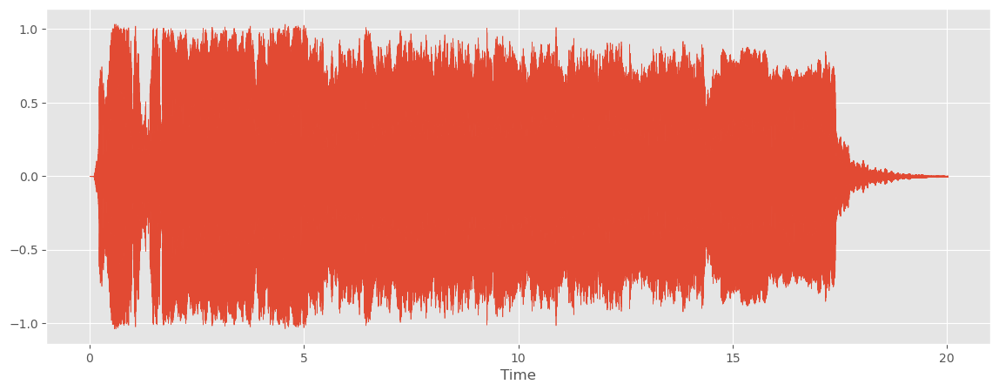

In [2]:
filename = r"C:\Users\ushine\Data Mining\Azan Sukses\dataset_full_stereo\ajam\ajam_1.wav"
plt.figure(figsize=(14,5))
data, sample_rate=librosa.load(filename)
librosa.display.waveshow(data, sr=sample_rate)
ipd.Audio(filename)

**Bayati**

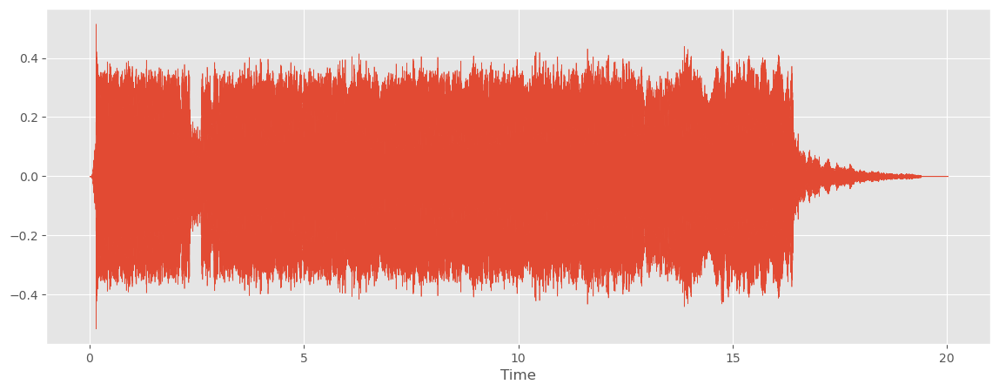

In [3]:
filename = r"C:\Users\ushine\Data Mining\Azan Sukses\dataset_full_stereo\bayati\bayati_1.wav"
plt.figure(figsize=(14,5))
data, sample_rate=librosa.load(filename)
librosa.display.waveshow(data, sr=sample_rate)
ipd.Audio(filename)

**Hijaz**

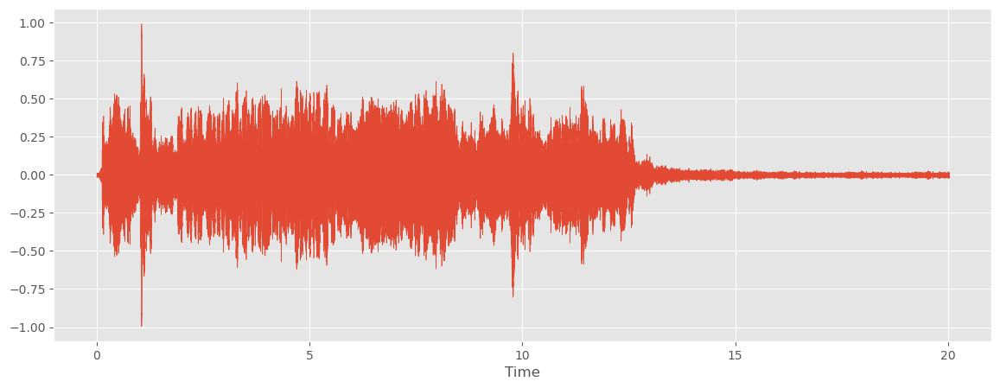

In [4]:
filename = r"C:\Users\ushine\Data Mining\Azan Sukses\dataset_full_stereo\hijaz\hijaz_1.wav"
plt.figure(figsize=(14,5))
data, sample_rate=librosa.load(filename)
librosa.display.waveshow(data, sr=sample_rate)
ipd.Audio(filename)

**Nahawand**

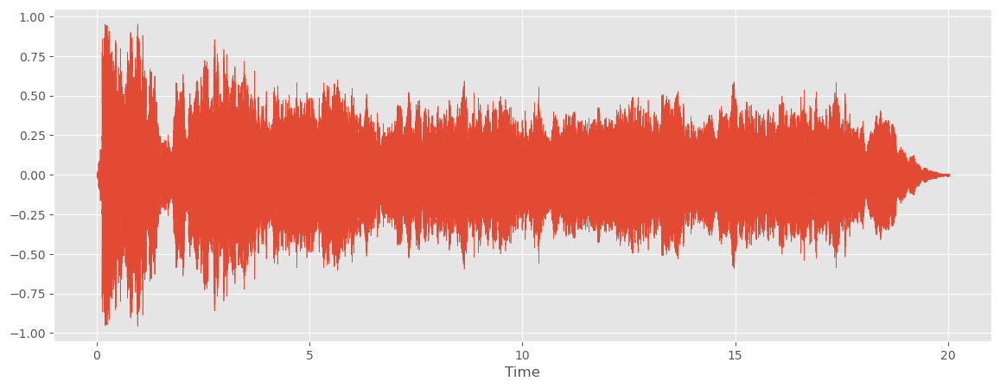

In [5]:
filename = r"C:\Users\ushine\Data Mining\Azan Sukses\dataset_full_stereo\nahawand\nahawand_1.wav"
plt.figure(figsize=(14,5))
data, sample_rate=librosa.load(filename)
librosa.display.waveshow(data, sr=sample_rate)
ipd.Audio(filename)

**Rast**

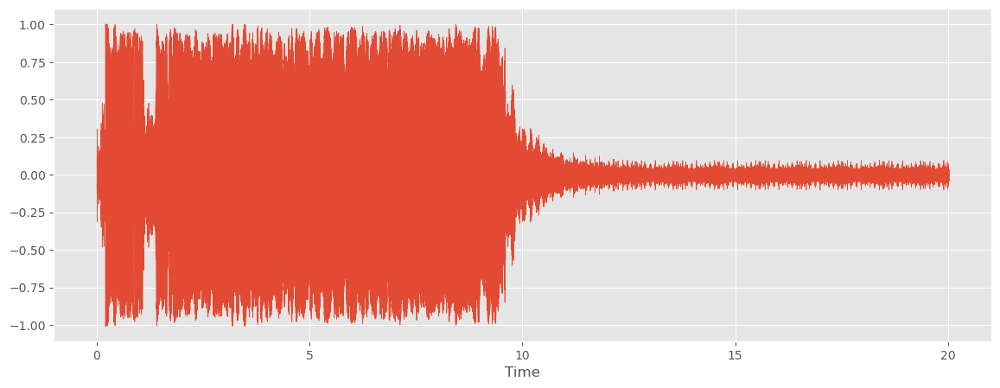

In [6]:
filename = r"C:\Users\ushine\Data Mining\Azan Sukses\dataset_full_stereo\rast\rast_1.wav"
plt.figure(figsize=(14,5))
data, sample_rate=librosa.load(filename)
librosa.display.waveshow(data, sr=sample_rate)
ipd.Audio(filename)

In [7]:
from scipy.io import wavfile as wav
wave_sample_rate, wave_audio=wav.read(filename)

In [8]:
wave_sample_rate

44100

**MFCC**

In [9]:
def features_extractor(file_name):
    audio, sample_rate = librosa.load(file_name)

    emphasized_audio = librosa.effects.preemphasis(y=audio, coef=0.97)

    mfccs_features = librosa.feature.mfcc(y=emphasized_audio,
                                          n_fft=2048,
                                          hop_length=512,
                                          sr=44100,
                                          window='hamming',
                                          dct_type=2,
                                          n_mfcc=20)
    mfccs_scaled_features = np.mean(mfccs_features.T, axis=0)

    return mfccs_scaled_features


In [10]:
audio_dataset_path = r"C:\Users\ushine\Data Mining\Azan Sukses\dataset_full_stereo"

extracted_features = []
for path in os.listdir(audio_dataset_path):
    for file in os.listdir(os.path.join(audio_dataset_path, path)):
        if file.lower().endswith(".wav"):
            file_name = os.path.join(audio_dataset_path, path, file)
            data = features_extractor(file_name)
            extracted_features.append([data, path])

In [11]:
f = open('./Extracted_Features.pkl', 'wb')
pickle.dump(extracted_features, f)
f.close()

In [12]:
f = open('./Extracted_Features.pkl', 'rb')
Data = pickle.load(f)
f.close()

In [13]:
df = pd.DataFrame(Data,columns=['feature','class'])
pd.set_option('max_colwidth', None)
pd.set_option('display.max_rows', None)
df

,feature,class
0,"[-261.3098, -52.891712, -51.763306, -29.179995, -34.430443, -8.912416, -6.053541, -27.304121, 19.078766, -2.471533, -31.498371, -3.3923218, -3.1677985, -19.15501, 2.8616178, -5.9269433, 17.509476, 31.611725, 3.10002, 19.41012]",ajam
1,"[-355.3325, 10.84215, -70.06596, -17.452538, -15.382382, -3.8258832, -13.067917, 21.799767, -16.524628, 19.916185, -29.346987, -9.3166485, 8.650343, -11.731097, -4.908741, 0.3091635, -2.0606182, 18.304731, 12.23881, 11.846486]",ajam
2,"[-370.8905, 23.209574, -146.60146, 25.487497, -34.16751, 3.3698637, -19.72175, -25.950598, 14.416696, -12.403556, 10.999868, 33.463207, -17.84885, -13.774544, -23.054302, 0.93549824, 4.756537, -5.8143754, -0.88540274, -5.9517984]",ajam
3,"[-496.22083, -28.793537, -31.610834, 3.1113513, -4.524768, 9.217698, -14.5266285, 1.7865554, -2.3615978, -10.269358, 11.690695, 3.09741, 12.797483, 3.289489, 9.202082, -6.520416, -5.9578104, -3.245901, 2.3081238, 4.279382]",ajam
4,"[-460.27368, -18.983969, -5.5027013, -15.450212, -39.2385, 0.5413514, -12.944755, 3.9478185, -2.786606, -7.0840306, -20.925041, 2.007191, -4.010717, -6.516416, 5.7108817, 4.529273, 3.540004, 5.742252, -3.0052621, 11.7079]",ajam
5,"[-528.2043, 9.478332, -24.36287, -25.459904, -14.626672, -11.0578, -17.606697, -8.259672, -11.5354595, -10.495481, -23.996904, -2.8980324, -2.4426866, 5.162803, 11.327846, 16.277817, 7.741314, 6.8225927, -12.862613, 3.2056906]",ajam
6,"[-340.9193, -74.2652, -44.528805, -26.336208, -1.9627665, 3.1182046, 1.9739988, -13.032729, -7.6494513, -12.741814, -16.10031, 20.06666, 7.070809, 9.660137, 8.743427, 5.3919353, -5.265959, -10.576431, -0.18447016, 5.4292984]",ajam
7,"[-339.01514, -27.49043, -35.869907, -37.96146, -12.437581, 20.404612, -23.872458, 25.712503, -15.056827, -10.379112, -39.78402, 10.916353, -18.466368, -5.183219, -26.330498, 7.785976, -2.6741452, 0.29030865, 8.885947, 9.242194]",ajam
8,"[-321.52176, -25.57415, -33.424282, -40.716343, -16.800346, 16.08797, -16.112864, 20.383394, -12.134632, -8.307762, -34.26052, 3.9942868, -21.70689, -2.6583261, -26.630178, 3.9643238, -2.110402, 3.2240272, 6.127324, 2.6777616]",ajam
9,"[-341.37183, -14.449502, -38.605946, -45.809532, -15.829557, 18.055414, -25.668974, 22.25693, -13.462678, -4.8190107, -39.09911, -2.0964997, -15.674016, -1.1443025, -34.906155, 12.297717, 1.7298131, 0.16223979, 4.5651484, 5.207497]",ajam


**Data Splitting**

In [14]:
X = np.array(df['feature'].tolist())
y = np.array(df['class'].tolist())

In [15]:
X.shape

(250, 20)

In [16]:
y.shape

(250,)

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 250 entries, 0 to 249
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   feature  250 non-null    object
 1   class    250 non-null    object
dtypes: object(2)
memory usage: 4.0+ KB


In [18]:
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_encoded.shape



(250,)

In [19]:
y = to_categorical(y_encoded)
y

array([[1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       ...,
       [0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 1.]], dtype=float32)

In [20]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.model_selection import ParameterGrid
import numpy as np
import random
import time

# Inisialisasi variabel untuk mengukur waktu total runtime
total_runtime_start = time.time()

# Fungsi untuk membuat model
def create_model(units_layer1=1024, dropout_rate1=0.5, units_layer2=512, dropout_rate2=0.2,
                 units_layer3=256, dropout_rate3=0.1, units_layer4=128, units_layer5=64, learning_rate=0.001):
    model = tf.keras.models.Sequential([
        tf.keras.layers.Dense(units=units_layer1, input_shape=(20,), activation="relu"),
        tf.keras.layers.Dropout(dropout_rate1),
        tf.keras.layers.Dense(units=units_layer2, activation="relu"),
        tf.keras.layers.Dropout(dropout_rate2),
        tf.keras.layers.Dense(units=units_layer3, activation="relu"),
        tf.keras.layers.Dropout(dropout_rate3),
        tf.keras.layers.Dense(units=units_layer4, activation="relu"),
        tf.keras.layers.Dense(units=units_layer5, activation="relu"),
        tf.keras.layers.Dense(units=5, activation="softmax")
    ])

    optimizer = tf.keras.optimizers.Adam(learning_rate)
    model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    return model

# Definisikan hyperparameters yang akan ditune
param_grid = {
    'units_layer1': [1024, 2048],
    'dropout_rate1': [0.3, 0.4],
    'units_layer2': [512, 1024],
    'dropout_rate2': [0.1, 0.2],
    'units_layer3': [128, 256],
    'dropout_rate3': [0.1, 0.2],
    'units_layer4': [128, 256],
    'units_layer5': [64, 128],
    'learning_rate': [0.0001, 0.001]
}

# Inisialisasi variabel
best_accuracy = 0.0
best_hyperparameters = {}
results_data = []

# Lakukan pencarian hyperparameter secara manual
for i, hyperparameters in enumerate(ParameterGrid(param_grid)):
    accuracies = []

    # Split data menjadi train dan test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=random.randint(1, 1000))

    # Buat dan compile model
    model = create_model(**hyperparameters)

    # Latih model
    model.fit(X_train, y_train, epochs=50, batch_size=64, verbose=0)

    # Evaluasi model pada validation set
    _, accuracy = model.evaluate(X_test, y_test, verbose=0)
    accuracies.append(accuracy)

    # Tampilkan parameter dan akurasi untuk setiap percobaan
    print(f"Iteration {i + 1} - Hyperparameters: {hyperparameters}, Accuracy: {accuracy}")

    # Hitung rata-rata akurasi untuk set pengaturan hyperparameter saat ini
    average_accuracy = np.mean(accuracies)

    # Perbarui hyperparameter terbaik jika konfigurasi saat ini lebih baik
    if average_accuracy > best_accuracy:
        best_accuracy = average_accuracy
        best_hyperparameters = hyperparameters

    # Simpan hasil dalam list
    results_data.append({
        'Iteration': i + 1,
        'Hyperparameters': hyperparameters,
        'Average Accuracy': average_accuracy,
        'Best Accuracy': best_accuracy
    })

# Hitung total runtime
total_runtime_end = time.time()
total_runtime_seconds = total_runtime_end - total_runtime_start

# Konversi total runtime ke jam, menit, detik
total_runtime_hours, remainder = divmod(total_runtime_seconds, 3600)
total_runtime_minutes, total_runtime_seconds = divmod(remainder, 60)

print(f"\nTotal Runtime: {int(total_runtime_hours)} jam, {int(total_runtime_minutes)} menit, {int(total_runtime_seconds)} detik")


Iteration 1 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 1024, 'units_layer2': 512, 'units_layer3': 128, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.25999999046325684
Iteration 2 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 1024, 'units_layer2': 512, 'units_layer3': 128, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.3799999952316284
Iteration 3 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 1024, 'units_layer2': 512, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 64}, Accuracy: 0.30000001192092896
Iteration 4 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 1024, 'units_layer2': 512, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5':

Iteration 28 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.46000000834465027
Iteration 29 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.4000000059604645
Iteration 30 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.23999999463558197
Iteration 31 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units

Iteration 60 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.4000000059604645
Iteration 61 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.6000000238418579
Iteration 62 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.5199999809265137
Iteration 63 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units_layer

Iteration 92 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.2199999988079071
Iteration 93 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.3799999952316284
Iteration 94 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.4000000059604645
Iteration 95 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units_l

Iteration 124 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.4399999976158142
Iteration 125 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.46000000834465027
Iteration 126 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.47999998927116394
Iteration 127 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units

Iteration 156 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.3799999952316284
Iteration 157 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.36000001430511475
Iteration 158 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.3199999928474426
Iteration 159 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'un

Iteration 188 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.46000000834465027
Iteration 189 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.46000000834465027
Iteration 190 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.46000000834465027
Iteration 191 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'unit

Iteration 220 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.3799999952316284
Iteration 221 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.30000001192092896
Iteration 222 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.3799999952316284
Iteration 223 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'un

Iteration 252 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.23999999463558197
Iteration 253 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.30000001192092896
Iteration 254 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.36000001430511475
Iteration 255 - Hyperparameters: {'dropout_rate1': 0.3, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'unit

Iteration 284 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.36000001430511475
Iteration 285 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.46000000834465027
Iteration 286 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.4000000059604645
Iteration 287 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'u

Iteration 316 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.47999998927116394
Iteration 317 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.5
Iteration 318 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.36000001430511475
Iteration 319 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units_layer5': 64}, 

Iteration 348 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.3400000035762787
Iteration 349 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.3400000035762787
Iteration 350 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.4000000059604645
Iteration 351 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'uni

Iteration 380 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.2800000011920929
Iteration 381 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.3199999928474426
Iteration 382 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.30000001192092896
Iteration 383 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.1, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units_

Iteration 412 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.23999999463558197
Iteration 413 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.3199999928474426
Iteration 414 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.3799999952316284
Iteration 415 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'un

Iteration 444 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.25999999046325684
Iteration 445 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.41999998688697815
Iteration 446 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.4399999976158142
Iteration 447 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units

Iteration 476 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.30000001192092896
Iteration 477 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.25999999046325684
Iteration 478 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.2199999988079071
Iteration 479 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.0001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'u

Iteration 508 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 128, 'units_layer4': 256, 'units_layer5': 128}, Accuracy: 0.4000000059604645
Iteration 509 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}, Accuracy: 0.5199999809265137
Iteration 510 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 128}, Accuracy: 0.3400000035762787
Iteration 511 - Hyperparameters: {'dropout_rate1': 0.4, 'dropout_rate2': 0.2, 'dropout_rate3': 0.2, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 256, 'units_l

In [21]:
# Print hasil
print("Best Hyperparameters: ", best_hyperparameters)
print("Best Accuracy: ", best_accuracy)

Best Hyperparameters:  {'dropout_rate1': 0.3, 'dropout_rate2': 0.1, 'dropout_rate3': 0.1, 'learning_rate': 0.001, 'units_layer1': 2048, 'units_layer2': 1024, 'units_layer3': 256, 'units_layer4': 128, 'units_layer5': 64}
Best Accuracy:  0.6000000238418579
